In [1]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import OneHotEncoder 
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import confusion_matrix, accuracy_score
from imblearn.over_sampling import SMOTE
from sklearn.model_selection import GridSearchCV
from sklearn.tree import DecisionTreeRegressor  

## Dataset

In [2]:
dataset=pd.read_excel(r'D:\Chindhu\RoadMap for Career\Data Science\Guvi\Python Codes\Copper Modeling\Copper_Set.xlsx')

In [3]:
dataset.head()

,id,item_date,quantity tons,customer,country,status,item type,application,thickness,width,material_ref,product_ref,delivery date,selling_price
0,EC06F063-9DF0-440C-8764-0B0C05A4F6AE,20210401.0,54.151139,30156308.0,28.0,Won,W,10.0,2.00,1500.0,DEQ1 S460MC,1670798778,20210701.0,854.00
1,4E5F4B3D-DDDF-499D-AFDE-A3227EC49425,20210401.0,768.024839,30202938.0,25.0,Won,W,41.0,0.80,1210.0,0000000000000000000000000000000000104991,1668701718,20210401.0,1047.00
2,E140FF1B-2407-4C02-A0DD-780A093B1158,20210401.0,386.127949,30153963.0,30.0,Won,WI,28.0,0.38,952.0,S0380700,628377,20210101.0,644.33
3,F8D507A0-9C62-4EFE-831E-33E1DA53BB50,20210401.0,202.411065,30349574.0,32.0,Won,S,59.0,2.30,1317.0,DX51D+ZM310MAO 2.3X1317,1668701718,20210101.0,768.00
4,4E1C4E78-152B-430A-8094-ADD889C9D0AD,20210401.0,785.526262,30211560.0,28.0,Won,W,10.0,4.00,2000.0,2_S275JR+AR-CL1,640665,20210301.0,577.00


In [4]:
dataset.dtypes

id                object
item_date        float64
quantity tons     object
customer         float64
country          float64
status            object
item type         object
application      float64
thickness        float64
width            float64
material_ref      object
product_ref        int64
delivery date    float64
selling_price    float64
dtype: object

In [5]:
dataset.shape

(181673, 14)

## Data Cleaning

### Handling Null / Missing Values :

In [6]:
dataset.isnull().sum()

id                   2
item_date            1
quantity tons        0
customer             1
country             28
status               2
item type            0
application         24
thickness            1
width                0
material_ref     77919
product_ref          0
delivery date        1
selling_price        1
dtype: int64

In [7]:
subDf = dataset.loc[dataset['id'].isin([np.NaN])]
subDf

,id,item_date,quantity tons,customer,country,status,item type,application,thickness,width,material_ref,product_ref,delivery date,selling_price
26,NaN,20210401.0,15.92799,30271717.0,28.0,To be approved,W,10.0,0.8,1000.0,NaN,611993,20210701.0,1208.0
104566,NaN,20201113.0,27.096376,30197989.0,27.0,Won,W,59.0,2.8,959.0,HRCL_DD 12 2.8X959,640665,20201201.0,551.0


In [8]:
dataset.loc[26,'id']='FFFFC917-6713-405F-A6B8-A69DE9160C3D'
dataset.loc[104566,'id']='FFFFC917-6713-405F-A6B8-A69DE9160C3D'

In [9]:
subDf_1 = dataset.loc[dataset['item_date'].isin([np.NaN])]
subDf_1

,id,item_date,quantity tons,customer,country,status,item type,application,thickness,width,material_ref,product_ref,delivery date,selling_price
104640,1BA92915-36FC-437A-811C-9DC7BF958EA6,NaN,51.785585,30230331.0,80.0,Lost,S,10.0,0.9,1435.0,NaN,628377,20210101.0,654.0


In [10]:
print(dataset['item_date'].mode())

0    20201202.0
Name: item_date, dtype: float64


In [11]:
dataset['item_date'].fillna(20201202.0, inplace=True)

In [12]:
subDf_2= dataset.loc[dataset['customer'].isin([np.NaN])]
subDf_2

,id,item_date,quantity tons,customer,country,status,item type,application,thickness,width,material_ref,product_ref,delivery date,selling_price
104684,6E764168-3F32-4E5D-BD67-4B1D959C75E3,20201112.0,205.266351,NaN,39.0,Won,W,10.0,3.5,1270.0,NaN,1670798778,20210201.0,650.0


In [13]:
print(dataset['customer'].mode())

0    30157111.0
Name: customer, dtype: float64


In [14]:
dataset['customer'].fillna(30157111, inplace=True)

In [15]:
subDf_3= dataset.loc[dataset['country'].isin([np.NaN])]
subDf_3

,id,item_date,quantity tons,customer,country,status,item type,application,thickness,width,material_ref,product_ref,delivery date,selling_price
104936,DA084B55-6789-4CC4-9F4F-361EE7C2614C,20201112.0,127.243871,3.019689e+07,NaN,Not lost for AM,S,10.0,3.50,1220.0,NaN,1668701718,20210201.0,810.0
104959,EA5FCEBF-D8D8-43D3-9CFB-9134634764CE,20201112.0,108.751059,3.019927e+07,NaN,Lost,S,10.0,3.50,1220.0,NaN,164141591,20210401.0,847.0
105007,4433B483-7929-4DE7-B467-6263B3C02DDF,20201112.0,30.156899,3.034185e+07,NaN,Not lost for AM,S,41.0,0.60,1250.0,NaN,611993,20210201.0,1099.0
105055,B689A281-5701-4D9A-B6C3-25BEA51B1656,20201112.0,52.086808,3.019859e+07,NaN,Not lost for AM,S,59.0,3.65,1409.0,MP0365PRSCJR1409,640665,20210101.0,575.0
108971,AE2513DD-4289-4B80-9F5A-C05F5FE14FA0,20201105.0,34.200136,2.147484e+09,NaN,To be approved,S,NaN,5.00,1500.0,NaN,640405,20210101.0,630.0
108973,A42A4216-082E-447E-9DA8-8FA43AAFDBE2,20201105.0,33.491866,2.147484e+09,NaN,Draft,S,NaN,6.00,1500.0,NaN,640405,20210101.0,19.0
108975,6CC87C58-D6BB-45F1-A2C2-637DA1E0E4A5,20201105.0,29.133722,2.147484e+09,NaN,Draft,S,NaN,8.00,1500.0,NaN,640405,20210101.0,12.0
108977,12EDD093-C1E3-4224-A367-AF9BC982519B,20201105.0,33.533078,2.147484e+09,NaN,Draft,S,NaN,9.99,1500.0,NaN,640405,20210101.0,21.0
108979,48CC05C8-17E7-49E1-ADD9-5B88CF8E6E5F,20201105.0,25.518348,2.147484e+09,NaN,Draft,S,NaN,11.99,1500.0,NaN,640405,20210101.0,21.0
108981,1D41F861-31AC-4177-97A3-F1AE6641A0F7,20201105.0,27.274928,2.147484e+09,NaN,Draft,S,NaN,14.99,1500.0,NaN,640405,20210101.0,20.0


In [16]:
print(dataset['country'].mode())

0    78.0
Name: country, dtype: float64


In [17]:
dataset['country'].fillna(78, inplace=True)

In [18]:
subDf_3= dataset.loc[dataset['application'].isin([np.NaN])]
subDf_3

,id,item_date,quantity tons,customer,country,status,item type,application,thickness,width,material_ref,product_ref,delivery date,selling_price
108971,AE2513DD-4289-4B80-9F5A-C05F5FE14FA0,20201105.0,34.200136,2.147484e+09,78.0,To be approved,S,NaN,5.00,1500.0,NaN,640405,20210101.0,630.0
108973,A42A4216-082E-447E-9DA8-8FA43AAFDBE2,20201105.0,33.491866,2.147484e+09,78.0,Draft,S,NaN,6.00,1500.0,NaN,640405,20210101.0,19.0
108975,6CC87C58-D6BB-45F1-A2C2-637DA1E0E4A5,20201105.0,29.133722,2.147484e+09,78.0,Draft,S,NaN,8.00,1500.0,NaN,640405,20210101.0,12.0
108977,12EDD093-C1E3-4224-A367-AF9BC982519B,20201105.0,33.533078,2.147484e+09,78.0,Draft,S,NaN,9.99,1500.0,NaN,640405,20210101.0,21.0
108979,48CC05C8-17E7-49E1-ADD9-5B88CF8E6E5F,20201105.0,25.518348,2.147484e+09,78.0,Draft,S,NaN,11.99,1500.0,NaN,640405,20210101.0,21.0
108981,1D41F861-31AC-4177-97A3-F1AE6641A0F7,20201105.0,27.274928,2.147484e+09,78.0,Draft,S,NaN,14.99,1500.0,NaN,640405,20210101.0,20.0
108983,6BFB864D-7287-4E9B-BC5E-7DEB16ACF0D5,20201105.0,33.130689,2.147484e+09,78.0,Draft,S,NaN,5.00,1500.0,NaN,640405,20210101.0,12.0
108985,3BF4C439-BFD5-47C5-9A61-03F2E88E0803,20201105.0,25.582634,2.147484e+09,78.0,Draft,S,NaN,6.00,1500.0,NaN,640405,20210101.0,22.0
108987,69CB191E-CF03-4136-BA99-E1C2C3328A9B,20201105.0,26.776187,2.147484e+09,78.0,Draft,S,NaN,8.00,1500.0,NaN,640405,20210101.0,11.0
108989,FDE1A57E-799F-4BC3-966C-8F50A99438DC,20201105.0,25.24604,2.147484e+09,78.0,Draft,S,NaN,9.99,1500.0,NaN,640405,20210101.0,21.0


In [19]:
dataset['application'].mode()

0    10.0
Name: application, dtype: float64

In [20]:
dataset['application'].fillna(10, inplace=True)

In [21]:
subDf_4= dataset.loc[dataset['thickness'].isin([np.NaN])]
subDf_4

,id,item_date,quantity tons,customer,country,status,item type,application,thickness,width,material_ref,product_ref,delivery date,selling_price
104895,20838F01-B8AD-4432-B72F-4AC8FBD884A6,20201112.0,56.464701,30205825.0,25.0,Not lost for AM,W,10.0,NaN,1500.0,NaN,1332077137,20210401.0,704.0


In [22]:
subDf_5 = dataset.query('(width == 1500.0) and (not thickness.isna())')
subDf_5['thickness'].median()

3.0

In [23]:
dataset['thickness'].fillna(3, inplace=True)

In [24]:
subDf_6= dataset.loc[dataset['material_ref'].isin([np.NaN])]
subDf_6

,id,item_date,quantity tons,customer,country,status,item type,application,thickness,width,material_ref,product_ref,delivery date,selling_price
12,EE7EE006-15B3-47A5-A48D-70D54C6B734C,20210401.0,27.512545,30165529.0,78.0,Won,W,10.0,0.75,1250.0,NaN,164141591,20210701.0,1098.0
14,99659229-166B-4966-AA1F-9796DA6055DB,20210401.0,10.41135,30271717.0,28.0,To be approved,W,10.0,0.60,1250.0,NaN,611993,20210701.0,1258.0
18,9CEF626C-6124-4C5C-9D54-0E5B8A8F2782,20210401.0,16.253987,30271717.0,28.0,To be approved,W,10.0,0.80,1250.0,NaN,611993,20210701.0,1193.0
22,93B04F7B-0A4C-4D45-AB3A-67DB7888869A,20210401.0,14.203574,30271717.0,28.0,To be approved,W,10.0,0.60,1000.0,NaN,611993,20210701.0,1265.0
26,FFFFC917-6713-405F-A6B8-A69DE9160C3D,20210401.0,15.92799,30271717.0,28.0,To be approved,W,10.0,0.80,1000.0,NaN,611993,20210701.0,1208.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
181652,F5EC467C-300D-4E85-BEF7-51999E0B7CA7,20200702.0,1.672379,30155929.0,25.0,Won,W,41.0,0.58,1220.0,NaN,611993,20200701.0,776.0
181653,497F5391-F450-4B49-870D-9B62A0274DD6,20200702.0,50.646907,30155929.0,25.0,Won,W,41.0,0.69,1220.0,NaN,611993,20200701.0,763.0
181654,04701946-E052-44C9-BCB5-C6AFC2EBFF7E,20200702.0,3.769829,30155929.0,25.0,Won,W,41.0,0.69,1220.0,NaN,611993,20200701.0,773.0
181655,D9E161D4-ACE6-47B5-ADB0-71FB3E95BF9A,20200702.0,220.875272,30155929.0,25.0,Won,W,41.0,0.69,1220.0,NaN,611993,20200701.0,766.0


In [25]:
dataset['material_ref'].fillna('', inplace=True)

In [26]:
result = dataset['material_ref'][dataset['material_ref'].str.startswith('00000')]
result

1         0000000000000000000000000000000000104991
5         0000000000000000000000000000000000102325
7         0000000000000000000000000000000001000944
8         0000000000000000000000000000000000106786
9         0000000000000000000000000000000000102325
                            ...                   
181668    0000000000000000000000000000000001000777
181669    0000000000000000000000000000000001000227
181670    0000000000000000000000000000000001004216
181671    0000000000000000000000000000000001001149
181672    0000000000000000000000000000000001005439
Name: material_ref, Length: 22726, dtype: object

In [27]:
dataset.loc[dataset['material_ref'].str.startswith('00000'), 'material_ref'] = ''

In [28]:
dataset['material_ref']=dataset['material_ref'].astype('category')

In [29]:
dataset['product_ref']=dataset['product_ref'].astype('category')

In [30]:
subDf_7= dataset.loc[dataset['delivery date'].isin([np.NaN])]
subDf_7

,id,item_date,quantity tons,customer,country,status,item type,application,thickness,width,material_ref,product_ref,delivery date,selling_price
104761,B9C4BAAE-25C3-468F-B315-63D57FA31C15,20201112.0,100.229137,30349338.0,26.0,Won,S,10.0,1.0,1300.0,,611993,NaN,1005.0


In [31]:
dataset['delivery date'].mode()

0    20210101.0
Name: delivery date, dtype: float64

In [32]:
dataset['delivery date'].fillna(20210101, inplace=True)

In [33]:
subDf_8= dataset.loc[dataset['selling_price'].isin([np.NaN])]
subDf_8

,id,item_date,quantity tons,customer,country,status,item type,application,thickness,width,material_ref,product_ref,delivery date,selling_price
104846,78C43232-2EB9-4AD7-899E-0E0BE14B2AE8,20201112.0,25.814926,30349625.0,80.0,Lost,S,15.0,1.2,1250.0,,628377,20210101.0,NaN


In [34]:
dataset['selling_price'].mean()

1918.0355051961778

In [35]:
dataset['selling_price'].median()

812.0

In [36]:
dataset['selling_price'].mode()

0    832.0
Name: selling_price, dtype: float64

In [37]:
dataset['selling_price'].fillna(812.0, inplace=True)

In [38]:
subDf_9= dataset.loc[dataset['quantity tons'].isin(['e'])]
subDf_9

,id,item_date,quantity tons,customer,country,status,item type,application,thickness,width,material_ref,product_ref,delivery date,selling_price
173086,3C0A018F-4A85-4D96-A1AA-72BF0F7DC6DD,20200714.0,e,30157111.0,78.0,Won,W,41.0,0.5,1000.0,,164141591,20200801.0,672.0


In [39]:
dataset.loc[173086,'quantity tons']=0

In [40]:
dataset['quantity tons'] = dataset['quantity tons'].astype(str).astype(float)

In [41]:
dataset.loc[173086,'quantity tons']=dataset['quantity tons'].median()

In [42]:
status_acceptable_value=((dataset['status']=='Won')|(dataset['status']=='Lost'))
status_acceptable_value

0         True
1         True
2         True
3         True
4         True
          ... 
181668    True
181669    True
181670    True
181671    True
181672    True
Name: status, Length: 181673, dtype: bool

In [43]:
status_reject_values=dataset[~status_acceptable_value]
status_reject_values

,id,item_date,quantity tons,customer,country,status,item type,application,thickness,width,material_ref,product_ref,delivery date,selling_price
6,E1B47219-42C8-411D-AE46-AD5256DC4757,20210401.0,3.522613,30209509.0,30.0,Draft,W,41.0,0.38,1125.0,NBW_L+_A_1125_0.4,611993,20210701.0,18.00
10,B85870F5-E1C7-4CAA-A7DA-355DC192B11D,20210401.0,9.175770,30209509.0,30.0,Draft,W,41.0,0.38,1125.0,NBW_L+_1125_0.4,611993,20210701.0,17.00
14,99659229-166B-4966-AA1F-9796DA6055DB,20210401.0,10.411350,30271717.0,28.0,To be approved,W,10.0,0.60,1250.0,,611993,20210701.0,1258.00
18,9CEF626C-6124-4C5C-9D54-0E5B8A8F2782,20210401.0,16.253987,30271717.0,28.0,To be approved,W,10.0,0.80,1250.0,,611993,20210701.0,1193.00
22,93B04F7B-0A4C-4D45-AB3A-67DB7888869A,20210401.0,14.203574,30271717.0,28.0,To be approved,W,10.0,0.60,1000.0,,611993,20210701.0,1265.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
181602,D85912F7-0002-4EC5-9CFD-AD3803F44D91,20200702.0,20.155119,30267349.0,84.0,Revised,W,10.0,2.00,1500.0,1S220A100P6FSA,164141591,20200701.0,619.81
181603,E6A94878-F80E-4852-A217-928D6D9C4A28,20200702.0,15.742266,30267349.0,84.0,Revised,W,10.0,2.00,1000.0,1S220A100P6FSA,164141591,20200701.0,628.52
181604,B40F8127-D4AC-44B6-B200-FED2690EA8EF,20200702.0,16.391009,30267349.0,84.0,Revised,W,10.0,2.00,1250.0,1S220A100P6FSA,164141591,20200701.0,615.81
181606,71B2FEB0-DB4C-47BE-848F-77A7705AB181,20200702.0,29.493106,30201589.0,84.0,Revised,S,15.0,0.80,1250.0,,1668701376,20200701.0,727.00


In [44]:
new_dataset=dataset[status_acceptable_value]
new_dataset

,id,item_date,quantity tons,customer,country,status,item type,application,thickness,width,material_ref,product_ref,delivery date,selling_price
0,EC06F063-9DF0-440C-8764-0B0C05A4F6AE,20210401.0,54.151139,30156308.0,28.0,Won,W,10.0,2.00,1500.0,DEQ1 S460MC,1670798778,20210701.0,854.00
1,4E5F4B3D-DDDF-499D-AFDE-A3227EC49425,20210401.0,768.024839,30202938.0,25.0,Won,W,41.0,0.80,1210.0,,1668701718,20210401.0,1047.00
2,E140FF1B-2407-4C02-A0DD-780A093B1158,20210401.0,386.127949,30153963.0,30.0,Won,WI,28.0,0.38,952.0,S0380700,628377,20210101.0,644.33
3,F8D507A0-9C62-4EFE-831E-33E1DA53BB50,20210401.0,202.411065,30349574.0,32.0,Won,S,59.0,2.30,1317.0,DX51D+ZM310MAO 2.3X1317,1668701718,20210101.0,768.00
4,4E1C4E78-152B-430A-8094-ADD889C9D0AD,20210401.0,785.526262,30211560.0,28.0,Won,W,10.0,4.00,2000.0,2_S275JR+AR-CL1,640665,20210301.0,577.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
181668,DE633116-D1DF-4846-982E-55EFC3658A76,20200702.0,102.482422,30200854.0,25.0,Won,W,41.0,0.96,1220.0,,164141591,20200701.0,591.00
181669,A48374B1-E6DB-45F2-889A-1F9C27C099EB,20200702.0,208.086469,30200854.0,25.0,Won,W,41.0,0.95,1500.0,,164141591,20200701.0,589.00
181670,91643238-5C7B-4237-9A5F-63AE3D35F320,20200702.0,4.235594,30200854.0,25.0,Won,W,41.0,0.71,1250.0,,164141591,20200701.0,619.00
181671,7AFFD323-01D9-4E15-B80D-7D1B03498FC8,20200702.0,-2000.000000,30200854.0,25.0,Won,W,41.0,0.85,1250.0,,164141591,20200701.0,601.00


In [45]:
new_dataset[new_dataset.isnull().any(axis=1)]

,id,item_date,quantity tons,customer,country,status,item type,application,thickness,width,material_ref,product_ref,delivery date,selling_price


In [46]:
new_dataset.dtypes

id                 object
item_date         float64
quantity tons     float64
customer          float64
country           float64
status             object
item type          object
application       float64
thickness         float64
width             float64
material_ref     category
product_ref      category
delivery date     float64
selling_price     float64
dtype: object

In [47]:
new_dataset.to_csv(r'D:\Chindhu\RoadMap for Career\Data Science\Guvi\Python Codes\Copper Modeling\new_dataset.csv',index=False)

### Skewness :

In [154]:
dataset=pd.read_csv(r'D:\Chindhu\RoadMap for Career\Data Science\Guvi\Python Codes\Copper Modeling\new_dataset.csv')

In [155]:
dataset_log={}

#### Quantity Tons :

C:\Users\kasiv\AppData\Local\Programs\Python\Python312\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning:

invalid value encountered in log



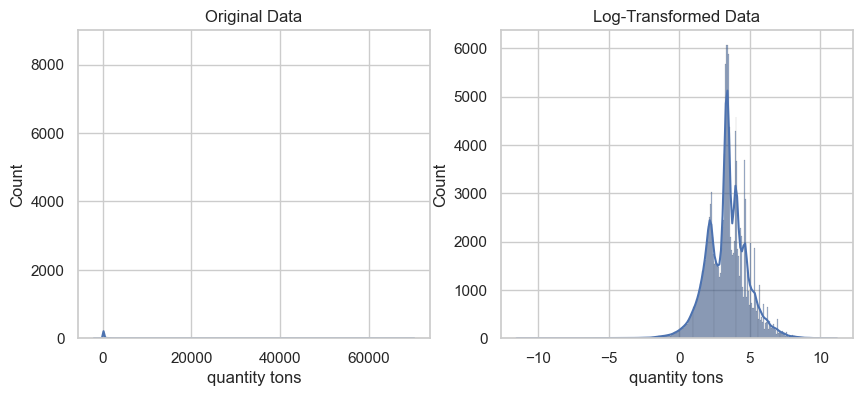

In [157]:
# Log-transform the 'quantity tons' column
dataset_log['quantity tons'] = np.log(dataset['quantity tons'])

# Define grid of plots
fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(10, 4))

# Create histograms with KDE
sns.histplot(data=dataset, x='quantity tons', kde=True, edgecolor='black', ax=axs[0])
sns.histplot(data=dataset_log, x='quantity tons', kde=True, edgecolor='black', ax=axs[1])

# Add title to each subplot
axs[0].set_title('Original Data')
axs[1].set_title('Log-Transformed Data')
plt.show()

In [158]:
skewness_before = dataset['quantity tons'].skew()
skewness_after = dataset_log['quantity tons'].skew()
print("Skewness Before Transform:", skewness_before)
print("Skewness After Transform:", skewness_after)

Skewness Before Transform: 53.79200410582946
Skewness After Transform: -0.050874138985331004


In [116]:
subDf = dataset.loc[dataset['quantity tons_log'].isin([np.NaN])]
subDf

,id,item_date,quantity tons,customer,country,status_encode_won,status_encode_lost,item_type_W,item_type_S,item_type_PL,...,thickness,width,material_ref,product_ref,delivery date,selling_price,quantity tons_log,thickness_log,selling_price_log,width_log
84318,36820BDA-8CDF-49F3-89A2-C50A55B70CEB,20201111.0,-4.0,30203192.0,27.0,1.0,0.0,0.0,1.0,0.0,...,1.50,1500.0,NaN,1332077137,20210101.0,723.0,NaN,0.405465,6.583409,7.313220
143572,802C8D24-710A-4A96-B3B1-F33F383EC455,20200702.0,-18.0,30200854.0,25.0,1.0,0.0,1.0,0.0,0.0,...,0.84,1220.0,NaN,164141591,20200701.0,590.0,NaN,-0.174353,6.380123,7.106606
143581,7AFFD323-01D9-4E15-B80D-7D1B03498FC8,20200702.0,-2000.0,30200854.0,25.0,1.0,0.0,1.0,0.0,0.0,...,0.85,1250.0,NaN,164141591,20200701.0,601.0,NaN,-0.162519,6.398595,7.130899


In [117]:
print(dataset['quantity tons_log'].mode())

0    3.413267
Name: quantity tons_log, dtype: float64


In [118]:
dataset['quantity tons_log'].fillna(3.413267, inplace=True)

#### Thickness :

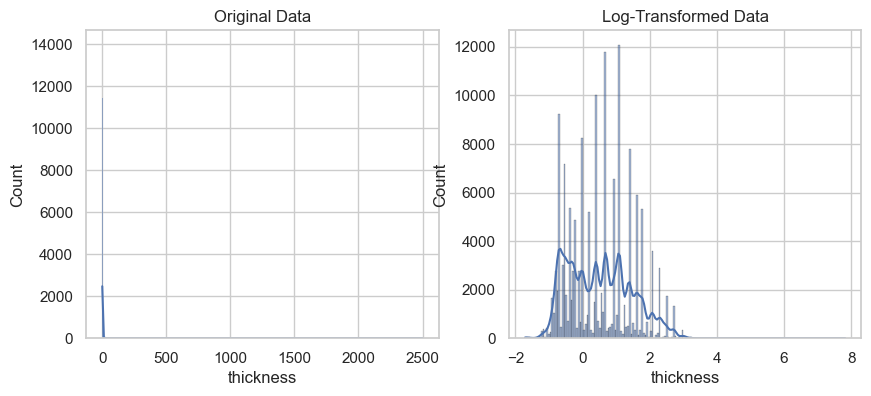

In [159]:
dataset_log['thickness'] = np.log(dataset['thickness'])

#define grid of plots
fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(10, 4))

#create histograms
sns.histplot(data=dataset, x='thickness', kde=True, edgecolor='black', ax=axs[0])
sns.histplot(data=dataset_log, x='thickness', kde=True, edgecolor='black', ax=axs[1])

#add title to each histogram
axs[0].set_title('Original Data')
axs[1].set_title('Log-Transformed Data')
plt.show()

In [160]:
skewness_before = dataset['thickness'].skew()
skewness_after = dataset_log['thickness'].skew()
print("Skewness Before Transform:", skewness_before)
print("Skewness After Transform:", skewness_after)

Skewness Before Transform: 288.70802917201587
Skewness After Transform: 0.32951151346976393


#### Width : Ignore the log transform of the feature as the original value is close to 0

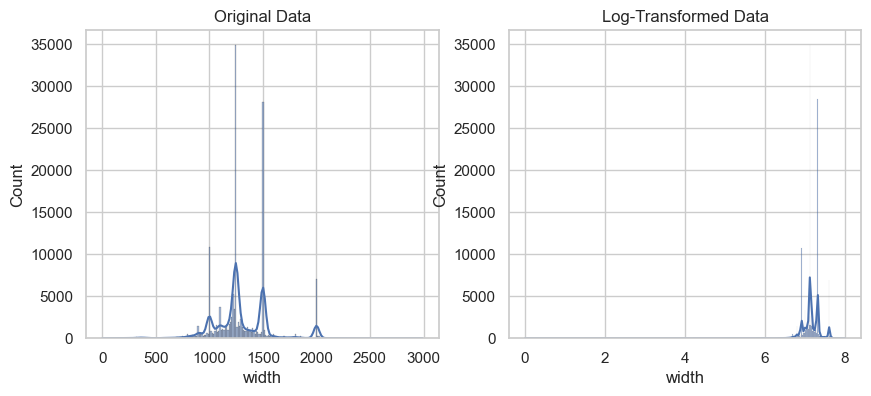

In [161]:
dataset_log['width'] = np.log(dataset['width'])

#define grid of plots
fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(10, 4))

#create histograms
sns.histplot(data=dataset, x='width', kde=True, edgecolor='black', ax=axs[0])
sns.histplot(data=dataset_log, x='width', kde=True, edgecolor='black', ax=axs[1])

#add title to each histogram
axs[0].set_title('Original Data')
axs[1].set_title('Log-Transformed Data')
plt.show()

In [162]:
skewness_before = dataset['width'].skew()
skewness_after = dataset_log['width'].skew()
print("Skewness Before Transform:", skewness_before)
print("Skewness After Transform:", skewness_after)

Skewness Before Transform: 0.3527508508617413
Skewness After Transform: -2.6742456502254206


#### Selling Price :

C:\Users\kasiv\AppData\Local\Programs\Python\Python312\Lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning:

invalid value encountered in log



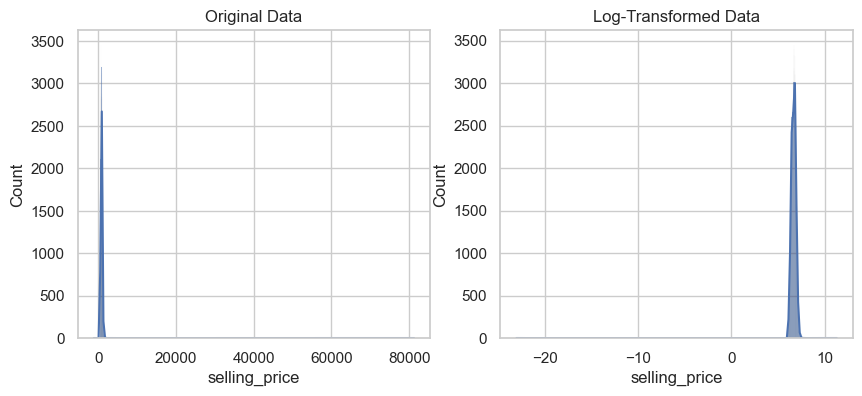

In [164]:
#define grid of plots
fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(10, 4))

# Add a small constant to avoid zero or negative values
constant = 1e-10
dataset_log['selling_price'] = np.log(dataset['selling_price'] + constant)

#create histograms
sns.histplot(data=dataset, x='selling_price', kde=True, edgecolor='black', ax=axs[0])
sns.histplot(data=dataset_log, x='selling_price', kde=True, edgecolor='black', ax=axs[1])

#add title to each histogram
axs[0].set_title('Original Data')
axs[1].set_title('Log-Transformed Data')
plt.show()

In [165]:
skewness_before = dataset['selling_price'].skew()
skewness_after = dataset_log['selling_price'].skew()
print("Skewness Before Transform:", skewness_before)
print("Skewness After Transform:", skewness_after)

Skewness Before Transform: 141.3287168147668
Skewness After Transform: -11.041600311904425


In [119]:
subDf = dataset.loc[dataset['selling_price_log'].isin([np.NaN])]
subDf

,id,item_date,quantity tons,customer,country,status_encode_won,status_encode_lost,item_type_W,item_type_S,item_type_PL,...,thickness,width,material_ref,product_ref,delivery date,selling_price,quantity tons_log,thickness_log,selling_price_log,width_log
22,BEC18863-E965-478B-9861-A49A77F26655,20210401.0,99.059199,30153510.0,30.0,1.0,0.0,1.0,0.0,0.0,...,0.595,1207.0,GOO1208X595SP,611993,20210401.0,-1160.0,4.595718,-0.519194,NaN,7.095893
35327,947C725B-85ED-4817-B4F8-27720314F9E6,20210204.0,101.397995,30198657.0,32.0,1.0,0.0,1.0,0.0,0.0,...,1.250,1100.0,NaN,1721130331,20210401.0,-730.0,4.619053,0.223144,NaN,7.003065
35366,35C64267-229F-438E-9A3B-91A6A41DACE2,20210203.0,12.225889,30157111.0,78.0,1.0,0.0,1.0,0.0,0.0,...,0.750,1250.0,NaN,164141591,20210401.0,-445.0,2.503556,-0.287682,NaN,7.130899
83906,8CA4D51F-DF96-4B88-805D-3937CCFDA810,20201112.0,5.280274,30209814.0,25.0,1.0,0.0,1.0,0.0,0.0,...,6.000,1250.0,NaN,1671863738,20210201.0,-336.0,1.663978,1.791759,NaN,7.130899


In [120]:
print(dataset['selling_price_log'].mode())

0    6.6995
Name: selling_price_log, dtype: float64


In [121]:
dataset['selling_price_log'].fillna(6.6995, inplace=True)

#### Merging log with the original dataset :

In [166]:
dataset['quantity tons_log'] = dataset_log['quantity tons']
dataset['thickness_log'] = dataset_log['thickness']
dataset['selling_price_log'] = dataset_log['selling_price']

In [167]:
dataset['width_log'] = dataset_log['width']

In [168]:
dataset.to_csv(r'D:\Chindhu\RoadMap for Career\Data Science\Guvi\Python Codes\Copper Modeling\Copper_Set_Skew_Clean.csv',index=False)

## EDA

In [88]:
#D:\Chindhu\RoadMap for Career\Data Science\Guvi\Python Codes\Copper Modeling\Copper_Set_Skew_Clean.csv
dataset=pd.read_csv(r'D:\Chindhu\RoadMap for Career\Data Science\Guvi\Python Codes\Copper Modeling\Copper_Set_Outlier_Removed.csv')

### Regression :

<Axes: xlabel='item type', ylabel='selling_price_log'>

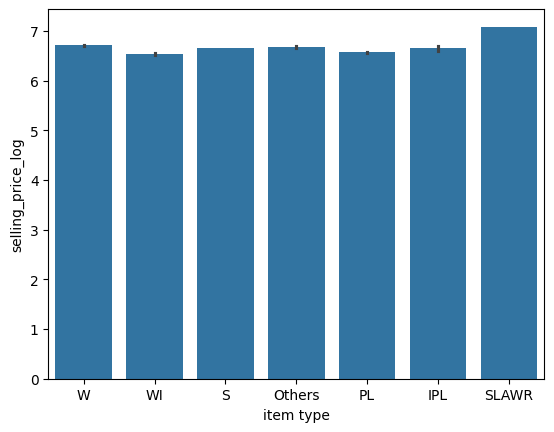

In [21]:
sns.barplot(dataset, x="item type", y="selling_price_log")

<Axes: xlabel='product_ref', ylabel='selling_price_log'>

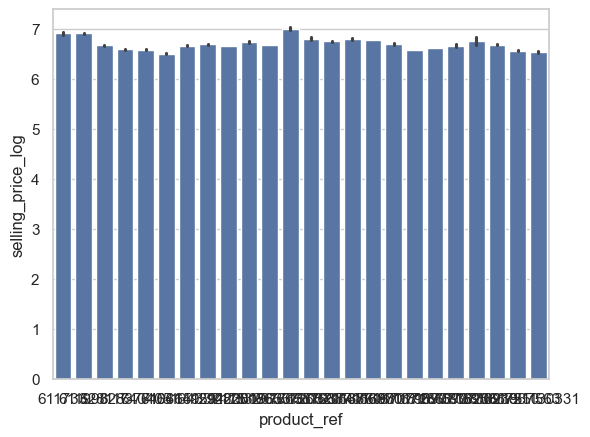

In [85]:
sns.barplot(dataset, x='product_ref',y='selling_price_log')

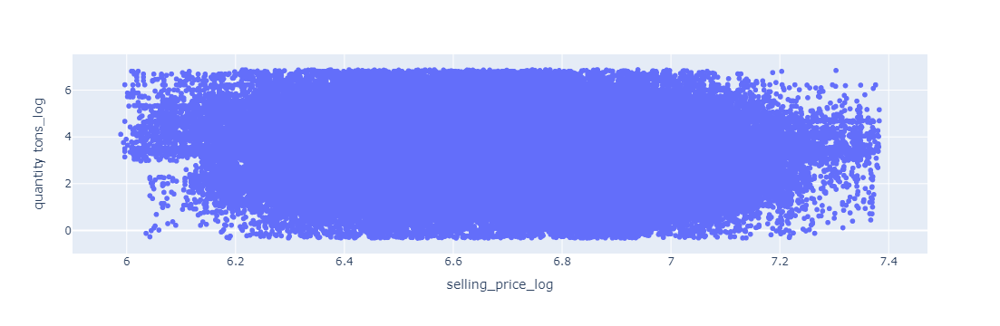

In [22]:
fig = px.scatter(dataset, x="selling_price_log", y="quantity tons_log", color_continuous_scale='Inferno')
fig.show()

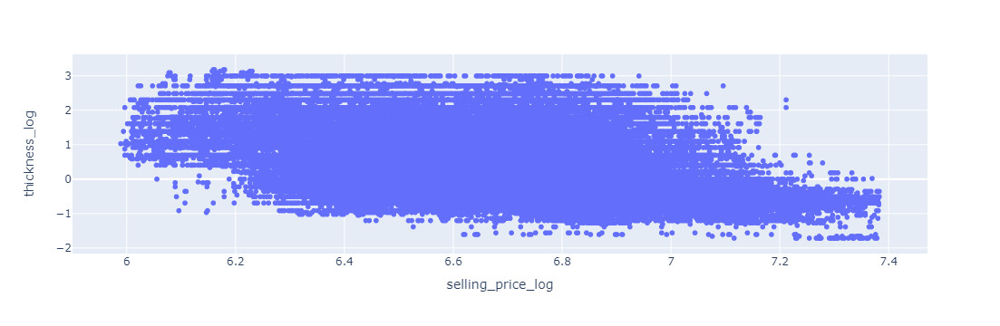

In [25]:
fig = px.scatter(dataset, x="selling_price_log", y="thickness_log", color_continuous_scale='Inferno')
fig.show()

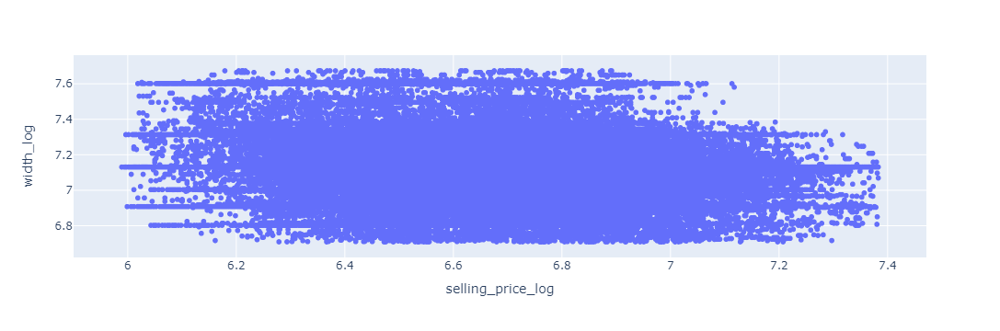

In [26]:
fig = px.scatter(dataset, x="selling_price_log", y="width_log", color_continuous_scale='Inferno')
fig.show()

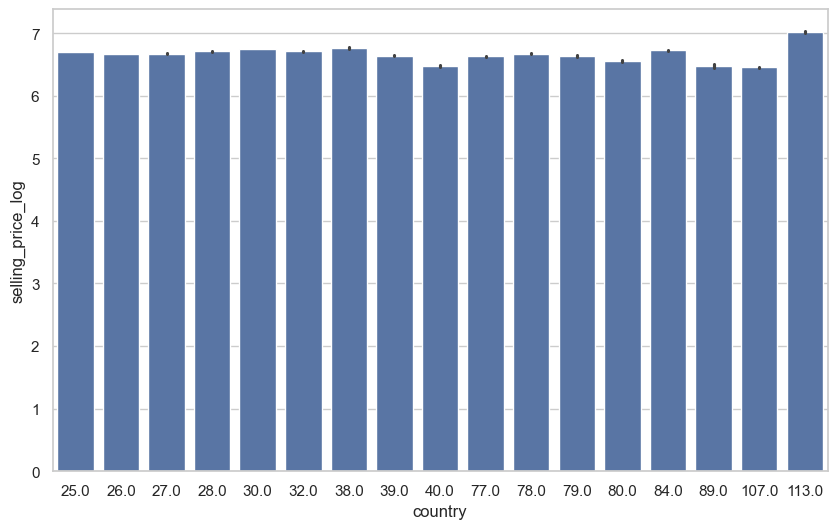

In [27]:
sns.set(style="whitegrid")

# Set the figure size
plt.figure(figsize=(10, 6))

# Create the bar plot
sns.barplot(data=dataset, x="country", y="selling_price_log")

# Show the plot
plt.show()

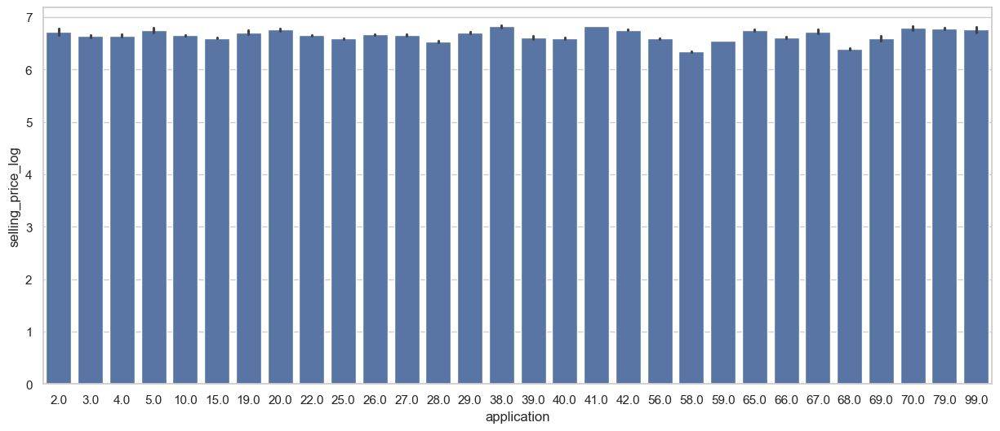

In [220]:
sns.set(style="whitegrid")

# Set the figure size
plt.figure(figsize=(15, 6))

# Create the bar plot
sns.barplot(data=dataset, x="application", y="selling_price_log")

# Show the plot
plt.show()

### Classification :

<Axes: ylabel='quantity tons_log'>

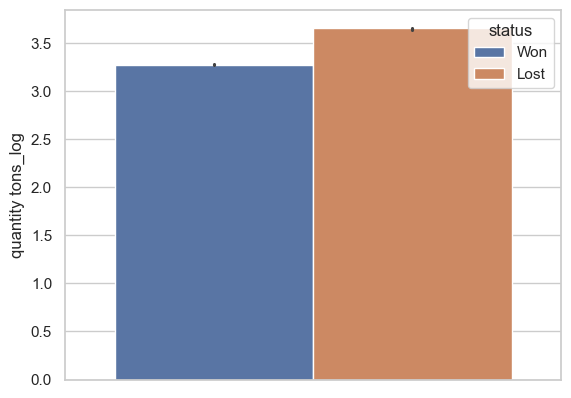

In [221]:
sns.barplot(dataset, y="quantity tons_log", hue="status")

<Axes: xlabel='item type', ylabel='quantity tons_log'>

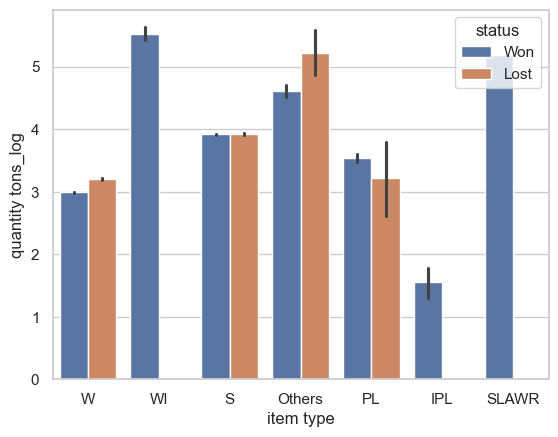

In [89]:
sns.barplot(dataset, x='item type', y="quantity tons_log", hue="status")

<Axes: xlabel='item type', ylabel='application'>

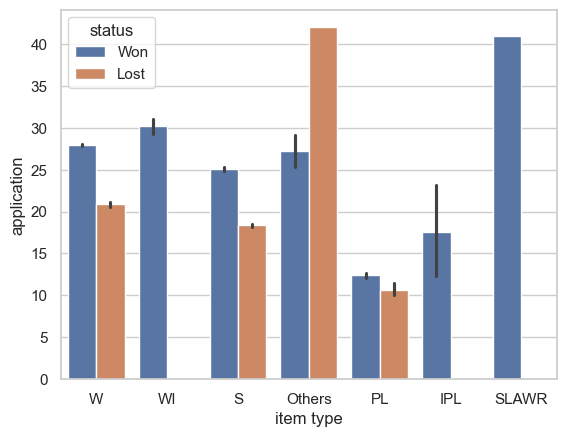

In [223]:
sns.barplot(dataset, x='item type', y="application", hue="status")

<Axes: xlabel='item type', ylabel='country'>

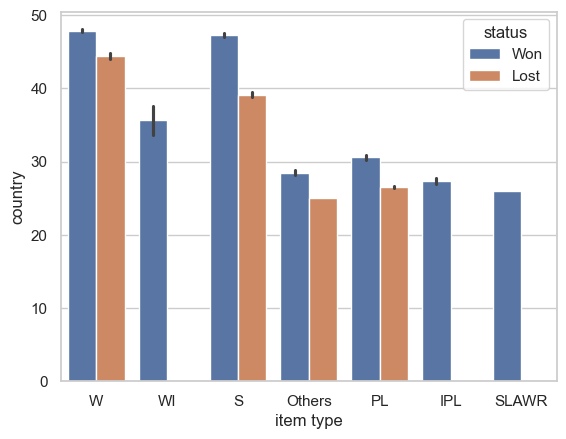

In [224]:
sns.barplot(dataset, x='item type', y="country", hue="status")

<Axes: xlabel='thickness_log', ylabel='Count'>

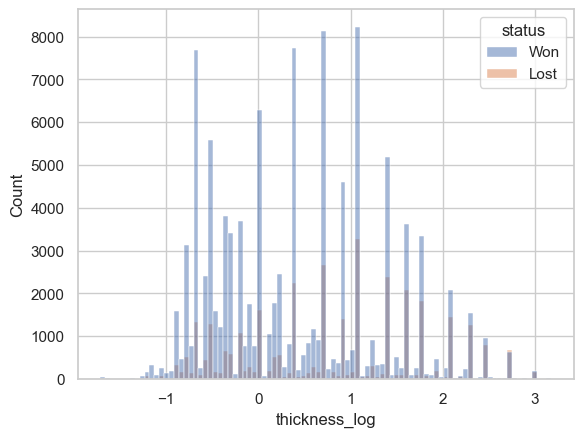

In [225]:
sns.histplot(dataset, x='thickness_log', hue="status")

<Axes: xlabel='width_log', ylabel='Count'>

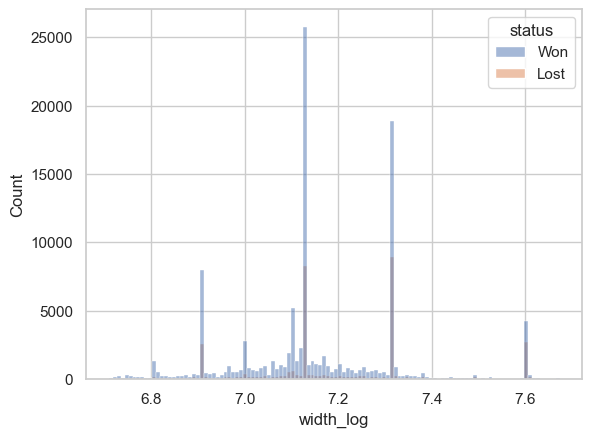

In [226]:
sns.histplot(dataset, x='width_log', hue="status")

## Data Cleaning

### Outliers :

In [28]:
dataset=pd.read_csv(r'D:\Chindhu\RoadMap for Career\Data Science\Guvi\Python Codes\Copper Modeling\Copper_Set_Skew_Clean.csv')

#### Quantity Tons

<Axes: xlabel='quantity tons_log'>

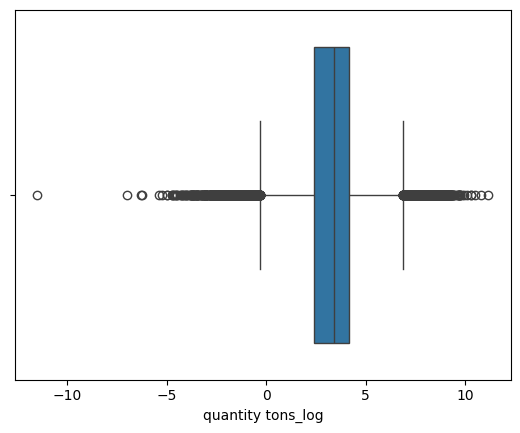

In [13]:
sns.boxplot(x=dataset['quantity tons_log'])

In [14]:
q1=dataset['quantity tons_log'].quantile(0.25)
q1

2.370249895803528

In [15]:
q3=dataset['quantity tons_log'].quantile(0.75)
q3

4.17238085358921

In [16]:
iqr=q3-q1
iqr

1.8021309577856823

In [17]:
lower=q1-1.5*iqr
lower

-0.33294654087499564

In [18]:
upper=q3+1.5*iqr
upper

6.875577290267734

In [19]:
outlier=((dataset['quantity tons_log']<lower)|(dataset['quantity tons_log']>upper))
outlier

0         False
1         False
2         False
3         False
4         False
          ...  
150443    False
150444    False
150445    False
150446    False
150447    False
Name: quantity tons_log, Length: 150448, dtype: bool

In [177]:
outlier_detected=dataset[outlier]
outlier_detected

,id,item_date,quantity tons,customer,country,status,item type,application,thickness,width,material_ref,product_ref,delivery date,selling_price,quantity tons_log,thickness_log,selling_price_log,width_log
147,9F7CA3F3-8B7B-4B89-87EC-7B90EB4FABEE,20210401.0,2908.995631,30153510.0,30.0,Won,S,41.0,0.32,1064.0,LIN1065X32B,611993,20210901.0,1167.49,7.975563,-1.139434,7.062611,6.969791
216,34EDAC5D-DDB5-4708-BD36-38C14C247CB8,20210401.0,1324.529613,30205376.0,25.0,Won,W,26.0,1.50,1250.0,HRPOS235_1.50,1670798778,20210701.0,1046.00,7.188813,0.405465,6.952729,7.130899
251,10DC0E51-CCD3-4C43-A57A-DB6D2701B663,20210401.0,0.628616,30214872.0,77.0,Won,W,15.0,15.00,1500.0,400 130025,640405,20210501.0,936.00,-0.464235,2.708050,6.841615,7.313220
499,7BFAEDCE-EE88-4375-B707-5C3CFFDFE22A,20210401.0,0.247442,30205312.0,32.0,Won,W,10.0,2.00,1250.0,NaN,1332077137,20210901.0,1069.00,-1.396580,0.693147,6.974479,7.130899
521,ACDA1C1B-6838-4F99-BE90-540DD4AF51D1,20210401.0,1308.558059,30160005.0,78.0,Won,W,41.0,1.50,1100.0,NaN,640665,20210601.0,893.00,7.176681,0.405465,6.794587,7.003065
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
150406,1220D493-CA0B-4D9F-A981-3D82DD2F6ADC,20200702.0,0.671656,30155929.0,25.0,Won,W,41.0,0.45,1220.0,NaN,611993,20200701.0,847.00,-0.398009,-0.798508,6.741701,7.106606
150410,6AB3B04C-091A-490C-91E4-EB6AD47C68E8,20200702.0,0.257052,30155929.0,25.0,Won,W,41.0,0.45,1250.0,NaN,611993,20200701.0,841.00,-1.358475,-0.798508,6.734592,7.130899
150420,B9060DFC-8598-4AE4-A81B-54BB3359DA15,20200702.0,0.170257,30155929.0,25.0,Won,W,41.0,0.55,1250.0,NaN,611993,20200701.0,781.00,-1.770444,-0.597837,6.660575,7.130899
150426,799DEA9C-981C-4E41-83EF-E3BD945AA6FE,20200702.0,978.297288,30155929.0,25.0,Won,W,41.0,0.58,1220.0,NaN,611993,20200701.0,759.00,6.885814,-0.544727,6.632002,7.106606


In [178]:
outlier_removed=dataset[~outlier]
outlier_removed

,id,item_date,quantity tons,customer,country,status,item type,application,thickness,width,material_ref,product_ref,delivery date,selling_price,quantity tons_log,thickness_log,selling_price_log,width_log
0,EC06F063-9DF0-440C-8764-0B0C05A4F6AE,20210401.0,54.151139,30156308.0,28.0,Won,W,10.0,2.00,1500.0,DEQ1 S460MC,1670798778,20210701.0,854.00,3.991779,0.693147,6.749931,7.313220
1,4E5F4B3D-DDDF-499D-AFDE-A3227EC49425,20210401.0,768.024839,30202938.0,25.0,Won,W,41.0,0.80,1210.0,NaN,1668701718,20210401.0,1047.00,6.643822,-0.223144,6.953684,7.098376
2,E140FF1B-2407-4C02-A0DD-780A093B1158,20210401.0,386.127949,30153963.0,30.0,Won,WI,28.0,0.38,952.0,S0380700,628377,20210101.0,644.33,5.956169,-0.967584,6.468211,6.858565
3,F8D507A0-9C62-4EFE-831E-33E1DA53BB50,20210401.0,202.411065,30349574.0,32.0,Won,S,59.0,2.30,1317.0,DX51D+ZM310MAO 2.3X1317,1668701718,20210101.0,768.00,5.310301,0.832909,6.643790,7.183112
4,4E1C4E78-152B-430A-8094-ADD889C9D0AD,20210401.0,785.526262,30211560.0,28.0,Won,W,10.0,4.00,2000.0,2_S275JR+AR-CL1,640665,20210301.0,577.00,6.666354,1.386294,6.357842,7.600902
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
150443,DE633116-D1DF-4846-982E-55EFC3658A76,20200702.0,102.482422,30200854.0,25.0,Won,W,41.0,0.96,1220.0,NaN,164141591,20200701.0,591.00,4.629691,-0.040822,6.381816,7.106606
150444,A48374B1-E6DB-45F2-889A-1F9C27C099EB,20200702.0,208.086469,30200854.0,25.0,Won,W,41.0,0.95,1500.0,NaN,164141591,20200701.0,589.00,5.337954,-0.051293,6.378426,7.313220
150445,91643238-5C7B-4237-9A5F-63AE3D35F320,20200702.0,4.235594,30200854.0,25.0,Won,W,41.0,0.71,1250.0,NaN,164141591,20200701.0,619.00,1.443523,-0.342490,6.428105,7.130899
150446,7AFFD323-01D9-4E15-B80D-7D1B03498FC8,20200702.0,-2000.000000,30200854.0,25.0,Won,W,41.0,0.85,1250.0,NaN,164141591,20200701.0,601.00,NaN,-0.162519,6.398595,7.130899


In [179]:
dataset=outlier_removed

#### Thickness

<Axes: xlabel='thickness_log'>

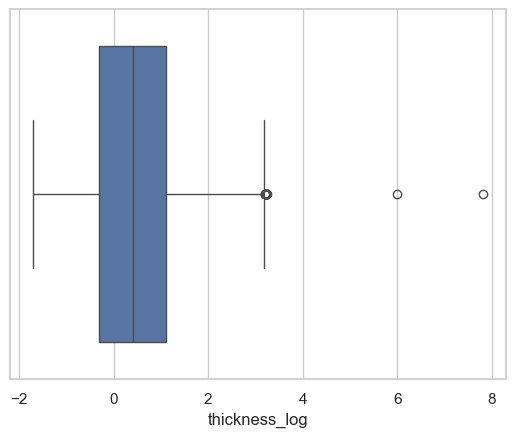

In [180]:
sns.boxplot(x=dataset['thickness_log']) # Skewed Right Data

In [181]:
q1_thick=dataset['thickness_log'].quantile(0.25)
q1_thick

-0.3011050927839216

In [182]:
q3_thick=dataset['thickness_log'].quantile(0.75)
q3_thick

1.0986122886681098

In [183]:
iqr_thick=q3_thick-q1_thick
iqr_thick

1.3997173814520314

In [184]:
lower_thick=q1_thick-1.5*iqr_thick
lower_thick

-2.4006811649619686

In [185]:
upper_thick=q3_thick+1.5*iqr_thick
upper_thick

3.1981883608461565

In [186]:
outlier_thick=((dataset['thickness_log']<lower_thick)|(dataset['thickness_log']>upper_thick))
outlier_thick

0         False
1         False
2         False
3         False
4         False
          ...  
150443    False
150444    False
150445    False
150446    False
150447    False
Name: thickness_log, Length: 147020, dtype: bool

In [187]:
outlier_detected_thick=dataset[outlier_thick]
outlier_detected_thick

,id,item_date,quantity tons,customer,country,status,item type,application,thickness,width,material_ref,product_ref,delivery date,selling_price,quantity tons_log,thickness_log,selling_price_log,width_log
32,77AE96A1-0FD6-4974-934D-2FA53C502087,20210401.0,59.907355,30202938.0,25.0,Won,W,41.0,2500.00,1260.0,NaN,1670798778,20210401.0,0.00,4.092799,7.824046,-23.025851,7.138867
33666,50EC7337-3ECF-49EE-9F48-D1AB2EFFCB9F,20210211.0,107.078907,30394392.0,26.0,Lost,S,59.0,24.50,1250.0,NaN,640665,20210701.0,858.00,4.673566,3.198673,6.754604,7.130899
33675,5300701D-B2ED-49E7-A205-728AEB750895,20210211.0,107.922002,30394392.0,26.0,Lost,S,59.0,24.50,1250.0,NaN,640665,20210701.0,854.00,4.681409,3.198673,6.749931,7.130899
33981,73021147-9CA4-4A02-9268-AE25242783F7,20210211.0,37.875354,30164695.0,27.0,Won,S,10.0,24.98,1500.0,BN002059,640665,20210401.0,793.38,3.634301,3.218076,6.676302,7.313220
33982,91A8A7E0-D400-4C74-9045-6A1E9D211C14,20210211.0,26.237354,30164695.0,27.0,Won,S,10.0,24.98,1000.0,BN002059,640665,20210401.0,803.38,3.267184,3.218076,6.688828,6.907755
34817,D4AEEBA5-A5B5-4EBF-B381-88AAB06B6B88,20210210.0,659.090824,30217497.0,25.0,Won,W,58.0,25.40,1600.0,X60M_AMP-20C,640665,20210701.0,473.00,6.490861,3.234749,6.159095,7.377759
34823,40DEB60B-EDC0-46E6-99C2-2DFEB35192CD,20210210.0,656.153950,30217497.0,25.0,Won,W,58.0,25.00,1600.0,X70M_S500M_AMP-20C,640665,20210701.0,507.00,6.486395,3.218876,6.228511,7.377759
34829,BA5432DF-86D6-400C-9F83-889151278F4B,20210210.0,654.416352,30217497.0,25.0,Won,W,58.0,25.00,1600.0,X70M_S500M_AMP-20C,640665,20210701.0,476.00,6.483744,3.218876,6.165418,7.377759
34831,ED999B1D-D426-4868-AF88-2169FEC4C575,20210210.0,651.728107,30217497.0,25.0,Won,W,58.0,25.00,1600.0,X60M_AMP-20C,640665,20210701.0,477.00,6.479627,3.218876,6.167516,7.377759
34833,214D9067-9B79-4045-BBF1-10E66BE942B8,20210210.0,652.928870,30217497.0,25.0,Won,W,58.0,24.99,1600.0,S355J2AMP MOD,640665,20210701.0,476.00,6.481468,3.218476,6.165418,7.377759


In [188]:
outlier_detected_thick.shape

(32, 18)

In [189]:
outlier_removed_thick=dataset[~outlier_thick]
outlier_removed_thick

,id,item_date,quantity tons,customer,country,status,item type,application,thickness,width,material_ref,product_ref,delivery date,selling_price,quantity tons_log,thickness_log,selling_price_log,width_log
0,EC06F063-9DF0-440C-8764-0B0C05A4F6AE,20210401.0,54.151139,30156308.0,28.0,Won,W,10.0,2.00,1500.0,DEQ1 S460MC,1670798778,20210701.0,854.00,3.991779,0.693147,6.749931,7.313220
1,4E5F4B3D-DDDF-499D-AFDE-A3227EC49425,20210401.0,768.024839,30202938.0,25.0,Won,W,41.0,0.80,1210.0,NaN,1668701718,20210401.0,1047.00,6.643822,-0.223144,6.953684,7.098376
2,E140FF1B-2407-4C02-A0DD-780A093B1158,20210401.0,386.127949,30153963.0,30.0,Won,WI,28.0,0.38,952.0,S0380700,628377,20210101.0,644.33,5.956169,-0.967584,6.468211,6.858565
3,F8D507A0-9C62-4EFE-831E-33E1DA53BB50,20210401.0,202.411065,30349574.0,32.0,Won,S,59.0,2.30,1317.0,DX51D+ZM310MAO 2.3X1317,1668701718,20210101.0,768.00,5.310301,0.832909,6.643790,7.183112
4,4E1C4E78-152B-430A-8094-ADD889C9D0AD,20210401.0,785.526262,30211560.0,28.0,Won,W,10.0,4.00,2000.0,2_S275JR+AR-CL1,640665,20210301.0,577.00,6.666354,1.386294,6.357842,7.600902
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
150443,DE633116-D1DF-4846-982E-55EFC3658A76,20200702.0,102.482422,30200854.0,25.0,Won,W,41.0,0.96,1220.0,NaN,164141591,20200701.0,591.00,4.629691,-0.040822,6.381816,7.106606
150444,A48374B1-E6DB-45F2-889A-1F9C27C099EB,20200702.0,208.086469,30200854.0,25.0,Won,W,41.0,0.95,1500.0,NaN,164141591,20200701.0,589.00,5.337954,-0.051293,6.378426,7.313220
150445,91643238-5C7B-4237-9A5F-63AE3D35F320,20200702.0,4.235594,30200854.0,25.0,Won,W,41.0,0.71,1250.0,NaN,164141591,20200701.0,619.00,1.443523,-0.342490,6.428105,7.130899
150446,7AFFD323-01D9-4E15-B80D-7D1B03498FC8,20200702.0,-2000.000000,30200854.0,25.0,Won,W,41.0,0.85,1250.0,NaN,164141591,20200701.0,601.00,NaN,-0.162519,6.398595,7.130899


In [190]:
dataset=outlier_removed_thick

#### Width

<Axes: xlabel='width_log'>

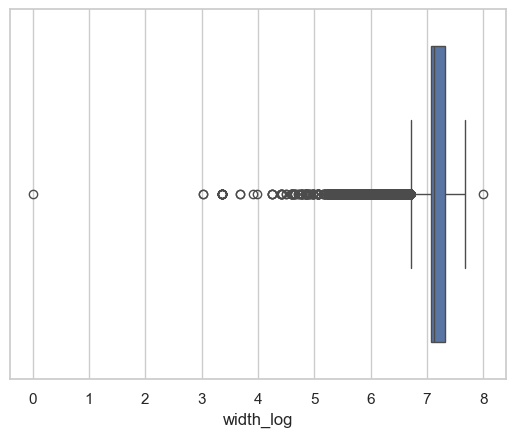

In [192]:
sns.boxplot(x=dataset['width_log'])

In [193]:
q1_width=dataset['width_log'].quantile(0.25)
q1_width

7.071573364211532

In [194]:
q3_width=dataset['width_log'].quantile(0.75)
q3_width

7.313220387090301

In [195]:
iqr_width=q3_width-q1_width
iqr_width

0.2416470228787695

In [196]:
lower_width=q1_width-1.5*iqr_width
lower_width

6.709102829893378

In [197]:
upper_width=q3_width+1.5*iqr_width
upper_width

7.675690921408456

In [198]:
outlier_width=((dataset['width_log']<lower_width)|(dataset['width_log']>upper_width))
outlier_width

0         False
1         False
2         False
3         False
4         False
          ...  
150443    False
150444    False
150445    False
150446    False
150447    False
Name: width_log, Length: 146988, dtype: bool

In [199]:
outlier_detected_width=dataset[outlier_width]
outlier_detected_width

,id,item_date,quantity tons,customer,country,status,item type,application,thickness,width,material_ref,product_ref,delivery date,selling_price,quantity tons_log,thickness_log,selling_price_log,width_log
41,D95278F5-203E-4554-8F07-E22F462DFD37,20210401.0,30.899950,30336279.0,78.0,Won,S,59.0,3.00,800.0,S235JR+AR_CL1,640665,20210501.0,846.0,3.430755,1.098612,6.740519,6.684612
66,5DE5D611-5790-416B-8AE3-4C7D56EE07E8,20210401.0,21.965842,30213691.0,79.0,Won,S,10.0,1.50,779.0,NaN,640665,20210401.0,909.0,3.089489,0.405465,6.812345,6.658011
115,788BB9FA-7B8E-4913-8844-2250DD4A9EB9,20210401.0,6.444309,30223403.0,78.0,Won,W,10.0,1.00,800.0,NaN,1668701718,20210701.0,1164.0,1.863197,0.000000,7.059618,6.684612
352,BC4CDA98-51D6-4B97-BFE0-4DE6BEBECEB3,20210401.0,110.765904,30407192.0,32.0,Lost,W,20.0,0.80,770.0,77532771AEGF40CSA,611993,20210701.0,1465.0,4.707419,-0.223144,7.289611,6.646391
455,52079C90-DCF1-44B8-8492-91243F954830,20210401.0,5.083541,30330352.0,78.0,Won,W,10.0,2.40,1.0,NaN,1670798778,20210701.0,956.0,1.626008,0.875469,6.862758,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
149921,42E38EB9-8888-436D-AAC1-5B6B9AAB9AF6,20200702.0,1.484105,30148586.0,32.0,Won,W,41.0,1.50,692.0,9010/35/692/1.5,611993,20200701.0,819.0,0.394812,0.405465,6.708084,6.539586
149987,EBC4A342-5AA7-4CBE-A0D1-F49A91D5E726,20200702.0,9.968068,30148586.0,32.0,Won,W,41.0,1.50,692.0,7032/7/7032/7/692/1.50,611993,20200701.0,814.0,2.299387,0.405465,6.701960,6.539586
150086,68CB8420-7F42-4F13-ABA3-E96C79D07F2C,20200702.0,105.177171,30164721.0,27.0,Won,S,66.0,5.85,710.0,8655_AVI_38MNB5,640665,20200901.0,640.0,4.655646,1.766442,6.461468,6.565265
150087,59F28821-DB77-4C56-A231-F0D6398C05B5,20200702.0,100.611013,30164721.0,27.0,Won,S,66.0,7.85,770.0,8655_AVI_38MNB5,640665,20200901.0,649.0,4.611262,2.060514,6.475433,6.646391


In [200]:
outlier_removed_width=dataset[~outlier_width]
outlier_removed_width

,id,item_date,quantity tons,customer,country,status,item type,application,thickness,width,material_ref,product_ref,delivery date,selling_price,quantity tons_log,thickness_log,selling_price_log,width_log
0,EC06F063-9DF0-440C-8764-0B0C05A4F6AE,20210401.0,54.151139,30156308.0,28.0,Won,W,10.0,2.00,1500.0,DEQ1 S460MC,1670798778,20210701.0,854.00,3.991779,0.693147,6.749931,7.313220
1,4E5F4B3D-DDDF-499D-AFDE-A3227EC49425,20210401.0,768.024839,30202938.0,25.0,Won,W,41.0,0.80,1210.0,NaN,1668701718,20210401.0,1047.00,6.643822,-0.223144,6.953684,7.098376
2,E140FF1B-2407-4C02-A0DD-780A093B1158,20210401.0,386.127949,30153963.0,30.0,Won,WI,28.0,0.38,952.0,S0380700,628377,20210101.0,644.33,5.956169,-0.967584,6.468211,6.858565
3,F8D507A0-9C62-4EFE-831E-33E1DA53BB50,20210401.0,202.411065,30349574.0,32.0,Won,S,59.0,2.30,1317.0,DX51D+ZM310MAO 2.3X1317,1668701718,20210101.0,768.00,5.310301,0.832909,6.643790,7.183112
4,4E1C4E78-152B-430A-8094-ADD889C9D0AD,20210401.0,785.526262,30211560.0,28.0,Won,W,10.0,4.00,2000.0,2_S275JR+AR-CL1,640665,20210301.0,577.00,6.666354,1.386294,6.357842,7.600902
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
150443,DE633116-D1DF-4846-982E-55EFC3658A76,20200702.0,102.482422,30200854.0,25.0,Won,W,41.0,0.96,1220.0,NaN,164141591,20200701.0,591.00,4.629691,-0.040822,6.381816,7.106606
150444,A48374B1-E6DB-45F2-889A-1F9C27C099EB,20200702.0,208.086469,30200854.0,25.0,Won,W,41.0,0.95,1500.0,NaN,164141591,20200701.0,589.00,5.337954,-0.051293,6.378426,7.313220
150445,91643238-5C7B-4237-9A5F-63AE3D35F320,20200702.0,4.235594,30200854.0,25.0,Won,W,41.0,0.71,1250.0,NaN,164141591,20200701.0,619.00,1.443523,-0.342490,6.428105,7.130899
150446,7AFFD323-01D9-4E15-B80D-7D1B03498FC8,20200702.0,-2000.000000,30200854.0,25.0,Won,W,41.0,0.85,1250.0,NaN,164141591,20200701.0,601.00,NaN,-0.162519,6.398595,7.130899


In [201]:
dataset=outlier_removed_width

#### Selling Price

<Axes: xlabel='selling_price_log'>

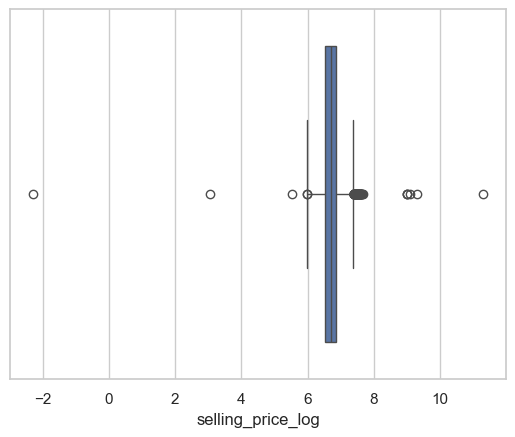

In [202]:
sns.boxplot(x=dataset['selling_price_log'])

In [203]:
q1_sp=dataset['selling_price_log'].quantile(0.25)
q1_sp

6.508769136971831

In [204]:
q3_sp=dataset['selling_price_log'].quantile(0.75)
q3_sp

6.858565034791471

In [205]:
iqr_sp=q3_sp-q1_sp
iqr_sp

0.3497958978196394

In [206]:
lower_sp=q1_sp-1.5*iqr_sp
lower_sp

5.984075290242372

In [207]:
upper_sp=q3_sp+1.5*iqr_sp
upper_sp

7.38325888152093

In [208]:
outlier_sp=((dataset['selling_price_log']<lower_sp)|(dataset['selling_price_log']>upper_sp))
outlier_sp

0         False
1         False
2         False
3         False
4         False
          ...  
150443    False
150444    False
150445    False
150446    False
150447    False
Name: selling_price_log, Length: 143778, dtype: bool

In [209]:
outlier_detected_sp=dataset[outlier_sp]
outlier_detected_sp

,id,item_date,quantity tons,customer,country,status,item type,application,thickness,width,material_ref,product_ref,delivery date,selling_price,quantity tons_log,thickness_log,selling_price_log,width_log
303,8D2D0F04-CA0C-4FEB-A6FC-3C1153C5BAFB,20210401.0,9.290574,30271717.0,28.0,Won,W,10.0,0.55,1000.0,NaN,611993,20210801.0,1710.00,2.229000,-0.597837,7.444249,6.907755
305,06B8C169-A947-407D-9B90-5E12ADA2DEB5,20210401.0,5.204757,30271717.0,28.0,Won,W,10.0,0.55,1250.0,NaN,611993,20210801.0,1700.00,1.649573,-0.597837,7.438384,7.130899
334,C7B00A5D-EF2C-49AF-8E1E-C296C9D67FD5,20210401.0,62.840175,30218009.0,32.0,Won,W,42.0,0.18,970.0,23890775539US3CSA,611993,20210701.0,1893.00,4.140595,-1.714798,7.545918,6.877296
336,ED063853-9C1F-4B74-B834-1733C771125B,20210401.0,70.933951,30218009.0,32.0,Won,W,42.0,0.57,1140.0,86723129539US3ATL,611993,20210701.0,1664.00,4.261749,-0.562119,7.416980,7.038784
340,AABE347C-6669-40BD-B8F2-39EA18FBD5C5,20210401.0,111.750484,30407192.0,32.0,Lost,W,20.0,0.50,1005.0,80323111AEGF40CSA,611993,20210701.0,1739.00,4.716269,-0.693147,7.461066,6.912743
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
131270,123985E4-0FF2-4884-B6BC-2CE61C701A01,20200813.0,18.797067,30206203.0,26.0,Lost,S,41.0,1.00,1250.0,NaN,611993,20201001.0,1642.00,2.933701,0.000000,7.403670,7.130899
143679,B8233A96-39B8-4DDE-827A-D1BA61755918,20200713.0,68.324191,30203386.0,40.0,Won,S,10.0,3.00,1250.0,NaN,640665,20200901.0,396.00,4.224264,1.098612,5.981414,7.130899
143682,E4A60BC4-1DBF-4191-8B1F-144EBFFD6574,20200713.0,71.621001,30203386.0,40.0,Won,S,10.0,3.00,1500.0,NaN,640665,20200901.0,396.00,4.271388,1.098612,5.981414,7.313220
144116,56DFBBF3-CD8E-41C5-9658-8D7224BF1B3A,20200713.0,31.215987,30155824.0,25.0,Won,S,10.0,0.70,1250.0,NaN,611993,20201001.0,1886.00,3.440930,-0.356675,7.542213,7.130899


In [210]:
outlier_removed_sp=dataset[~outlier_sp]
outlier_removed_sp

,id,item_date,quantity tons,customer,country,status,item type,application,thickness,width,material_ref,product_ref,delivery date,selling_price,quantity tons_log,thickness_log,selling_price_log,width_log
0,EC06F063-9DF0-440C-8764-0B0C05A4F6AE,20210401.0,54.151139,30156308.0,28.0,Won,W,10.0,2.00,1500.0,DEQ1 S460MC,1670798778,20210701.0,854.00,3.991779,0.693147,6.749931,7.313220
1,4E5F4B3D-DDDF-499D-AFDE-A3227EC49425,20210401.0,768.024839,30202938.0,25.0,Won,W,41.0,0.80,1210.0,NaN,1668701718,20210401.0,1047.00,6.643822,-0.223144,6.953684,7.098376
2,E140FF1B-2407-4C02-A0DD-780A093B1158,20210401.0,386.127949,30153963.0,30.0,Won,WI,28.0,0.38,952.0,S0380700,628377,20210101.0,644.33,5.956169,-0.967584,6.468211,6.858565
3,F8D507A0-9C62-4EFE-831E-33E1DA53BB50,20210401.0,202.411065,30349574.0,32.0,Won,S,59.0,2.30,1317.0,DX51D+ZM310MAO 2.3X1317,1668701718,20210101.0,768.00,5.310301,0.832909,6.643790,7.183112
4,4E1C4E78-152B-430A-8094-ADD889C9D0AD,20210401.0,785.526262,30211560.0,28.0,Won,W,10.0,4.00,2000.0,2_S275JR+AR-CL1,640665,20210301.0,577.00,6.666354,1.386294,6.357842,7.600902
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
150443,DE633116-D1DF-4846-982E-55EFC3658A76,20200702.0,102.482422,30200854.0,25.0,Won,W,41.0,0.96,1220.0,NaN,164141591,20200701.0,591.00,4.629691,-0.040822,6.381816,7.106606
150444,A48374B1-E6DB-45F2-889A-1F9C27C099EB,20200702.0,208.086469,30200854.0,25.0,Won,W,41.0,0.95,1500.0,NaN,164141591,20200701.0,589.00,5.337954,-0.051293,6.378426,7.313220
150445,91643238-5C7B-4237-9A5F-63AE3D35F320,20200702.0,4.235594,30200854.0,25.0,Won,W,41.0,0.71,1250.0,NaN,164141591,20200701.0,619.00,1.443523,-0.342490,6.428105,7.130899
150446,7AFFD323-01D9-4E15-B80D-7D1B03498FC8,20200702.0,-2000.000000,30200854.0,25.0,Won,W,41.0,0.85,1250.0,NaN,164141591,20200701.0,601.00,NaN,-0.162519,6.398595,7.130899


In [211]:
outlier_removed_sp.to_csv(r'D:\Chindhu\RoadMap for Career\Data Science\Guvi\Python Codes\Copper Modeling\Copper_Set_Outlier_Removed.csv',index=False)

### Data Conversion

In [2]:
dataset=pd.read_csv(r'D:\Chindhu\RoadMap for Career\Data Science\Guvi\Python Codes\Copper Modeling\Copper_Set_Outlier_Removed.csv')

In [31]:
dataset['status'].value_counts()

status
Won     109886
Lost     33697
Name: count, dtype: int64

In [2]:
enc = OneHotEncoder() 

In [33]:
status_encode = pd.DataFrame(enc.fit_transform( 
    dataset[['status']]).toarray()) 
status_encode

,0,1
0,0.0,1.0
1,0.0,1.0
2,0.0,1.0
3,0.0,1.0
4,0.0,1.0
...,...,...
143578,0.0,1.0
143579,0.0,1.0
143580,0.0,1.0
143581,0.0,1.0


In [34]:
status_encode.value_counts()

0    1  
0.0  1.0    109886
1.0  0.0     33697
Name: count, dtype: int64

In [35]:
dataset.drop(['status'], axis=1,inplace=True)

In [36]:
dataset.insert(5, "status_encode_won", status_encode[1], True)

In [37]:
dataset.insert(6, "status_encode_lost", status_encode[0], True)

In [52]:
dataset['item type'].value_counts()

item type
W         87674
S         51002
PL         4139
Others      379
WI          361
IPL          27
SLAWR         1
Name: count, dtype: int64

In [53]:
item_type_encode = pd.DataFrame(enc.fit_transform( 
    dataset[['item type']]).toarray()) 
item_type_encode

,0,1,2,3,4,5,6
0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
1,0.0,0.0,0.0,0.0,0.0,1.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,1.0
3,0.0,0.0,0.0,1.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...
143578,0.0,0.0,0.0,0.0,0.0,1.0,0.0
143579,0.0,0.0,0.0,0.0,0.0,1.0,0.0
143580,0.0,0.0,0.0,0.0,0.0,1.0,0.0
143581,0.0,0.0,0.0,0.0,0.0,1.0,0.0


In [54]:
item_type_encode.value_counts()

0    1    2    3    4    5    6  
0.0  0.0  0.0  0.0  0.0  1.0  0.0    87674
               1.0  0.0  0.0  0.0    51002
          1.0  0.0  0.0  0.0  0.0     4139
     1.0  0.0  0.0  0.0  0.0  0.0      379
     0.0  0.0  0.0  0.0  0.0  1.0      361
1.0  0.0  0.0  0.0  0.0  0.0  0.0       27
0.0  0.0  0.0  0.0  1.0  0.0  0.0        1
Name: count, dtype: int64

In [55]:
dataset.drop(['item type'], axis=1,inplace=True)

In [56]:
dataset.insert(7, "item_type_W", item_type_encode[5], True)

In [57]:
dataset.insert(8, "item_type_S", item_type_encode[3], True)

In [58]:
dataset.insert(9, "item_type_PL", item_type_encode[2], True)

In [59]:
dataset.insert(10, "item_type_WI", item_type_encode[6], True)

In [72]:
dataset.insert(11, "item_type_Others", item_type_encode[1], True)

In [73]:
dataset.insert(12, "item_type_IPL", item_type_encode[0], True)

In [74]:
dataset.insert(13, "item_type_SLAWR", item_type_encode[4], True)

In [124]:
dataset.to_csv(r'D:\Chindhu\RoadMap for Career\Data Science\Guvi\Python Codes\Copper Modeling\Copper_Set_Converted.csv',index=False)

## Feature Engineering

In [29]:
dataset=pd.read_csv(r'D:\Chindhu\RoadMap for Career\Data Science\Guvi\Python Codes\Copper Modeling\Copper_Set_Outlier_Removed.csv')

In [76]:
dataset.head()

,id,item_date,quantity tons,customer,country,status_encode_won,status_encode_lost,item_type_W,item_type_S,item_type_PL,...,thickness,width,material_ref,product_ref,delivery date,selling_price,quantity tons_log,thickness_log,selling_price_log,width_log
0,EC06F063-9DF0-440C-8764-0B0C05A4F6AE,20210401.0,54.151139,30156308.0,28.0,1.0,0.0,1.0,0.0,0.0,...,2.00,1500.0,DEQ1 S460MC,1670798778,20210701.0,854.00,3.991779,0.693147,6.749931,7.313220
1,4E5F4B3D-DDDF-499D-AFDE-A3227EC49425,20210401.0,768.024839,30202938.0,25.0,1.0,0.0,1.0,0.0,0.0,...,0.80,1210.0,NaN,1668701718,20210401.0,1047.00,6.643822,-0.223144,6.953684,7.098376
2,E140FF1B-2407-4C02-A0DD-780A093B1158,20210401.0,386.127949,30153963.0,30.0,1.0,0.0,0.0,0.0,0.0,...,0.38,952.0,S0380700,628377,20210101.0,644.33,5.956169,-0.967584,6.468211,6.858565
3,F8D507A0-9C62-4EFE-831E-33E1DA53BB50,20210401.0,202.411065,30349574.0,32.0,1.0,0.0,0.0,1.0,0.0,...,2.30,1317.0,DX51D+ZM310MAO 2.3X1317,1668701718,20210101.0,768.00,5.310301,0.832909,6.643790,7.183112
4,4E1C4E78-152B-430A-8094-ADD889C9D0AD,20210401.0,785.526262,30211560.0,28.0,1.0,0.0,1.0,0.0,0.0,...,4.00,2000.0,2_S275JR+AR-CL1,640665,20210301.0,577.00,6.666354,1.386294,6.357842,7.600902


<Axes: >

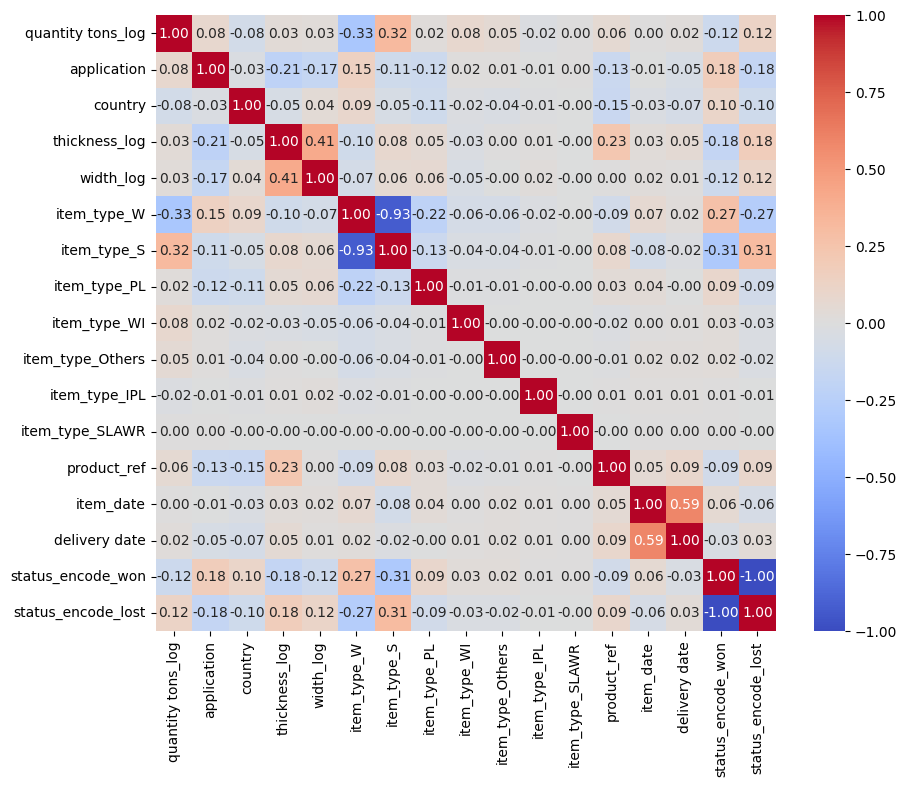

In [66]:
x=dataset[['quantity tons_log','application','country','thickness_log','width_log','item_type_W','item_type_S','item_type_PL','item_type_WI','item_type_Others','item_type_IPL','item_type_SLAWR','product_ref','item_date','delivery date','status_encode_won','status_encode_lost']].corr()

plt.figure(figsize=(10, 8))
sns.heatmap(x, annot=True, cmap="coolwarm", fmt=".2f")


<Axes: >

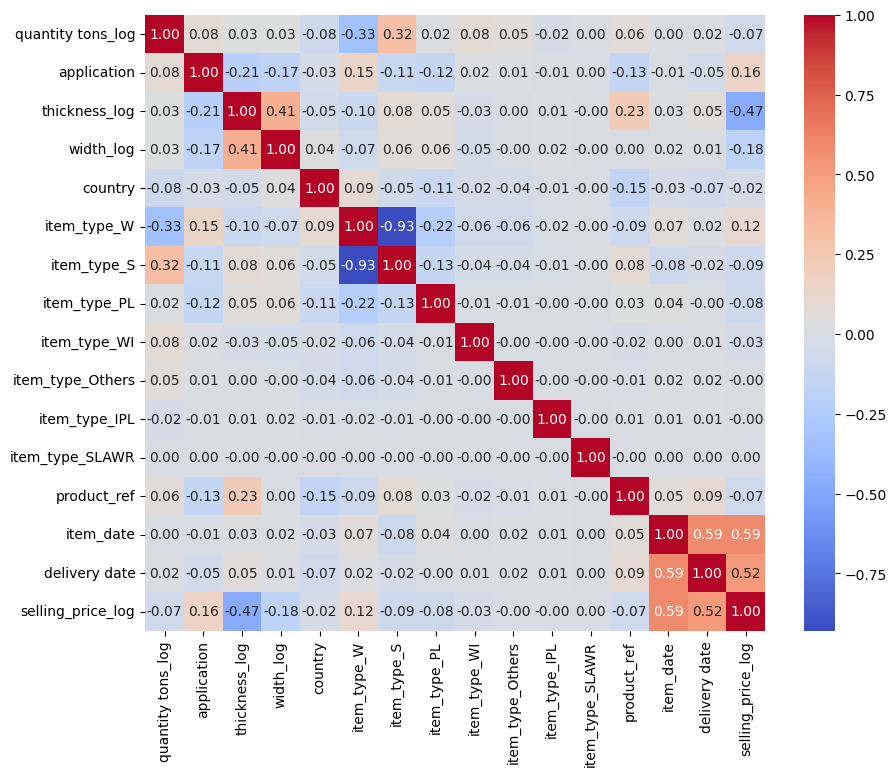

In [67]:
x=dataset[['quantity tons_log','application','thickness_log','width_log','country','item_type_W','item_type_S','item_type_PL','item_type_WI','item_type_Others','item_type_IPL','item_type_SLAWR','product_ref','item_date','delivery date','selling_price_log']].corr()

plt.figure(figsize=(10, 8))
sns.heatmap(x, annot=True, cmap="coolwarm", fmt=".2f")


## Model Building

### Decision Tree Classifier :

In [3]:
dataset=pd.read_csv(r'D:\Chindhu\RoadMap for Career\Data Science\Guvi\Python Codes\Copper Modeling\Copper_Set_Converted.csv')

In [4]:
dataset.isnull().sum()

id                        0
item_date                 0
quantity tons             0
customer                  0
country                   0
status_encode_won         0
status_encode_lost        0
item_type_W               0
item_type_S               0
item_type_PL              0
item_type_WI              0
item_type_Others          0
item_type_IPL             0
item_type_SLAWR           0
application               0
thickness                 0
width                     0
material_ref          78528
product_ref               0
delivery date             0
selling_price             0
quantity tons_log         0
thickness_log             0
selling_price_log         0
width_log                 0
dtype: int64

In [5]:
dataset[['status_encode_won']].value_counts()

status_encode_won
1                    109886
0                     33697
Name: count, dtype: int64

In [6]:
# ['quantity tons_log','country','application','thickness_log','width_log','product_ref','item_type_W','item_type_S','item_type_PL','item_type_WI','item_type_Others','item_type_IPL','item_type_SLAWR','item_date','delivery date']

In [7]:
X=dataset.iloc[:,[21,4,14,22,24,18,7,8,9,10,11,12,13,1,19]].values
y=dataset.iloc[:,[5]].values

In [8]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=0)

In [9]:
sc=StandardScaler()
sc.fit(X_train)
sc.transform(X_train)
sc.transform(X_test)

array([[-0.7919373 , -0.79930561,  1.96142221, ..., -0.00304734,
         1.24788772,  0.76738389],
       [-2.66493246,  1.31529913,  0.92804466, ..., -0.00304734,
         1.20484523,  0.67691393],
       [ 1.26961801, -0.83997109,  0.81322493, ..., -0.00304734,
         1.2483247 ,  0.63167895],
       ...,
       [ 0.00590579, -0.79930561, -0.56461181, ..., -0.00304734,
        -0.80394967, -1.38127764],
       [ 0.45652417, -0.79930561, -0.85166113, ..., -0.00304734,
        -0.76025172,  0.63167895],
       [ 1.76309513, -0.55531276,  1.96142221, ..., -0.00304734,
         1.24876167,  0.76738389]])

In [10]:
classifier=DecisionTreeClassifier(criterion='gini',random_state=0)
classifier.fit(X_train,y_train)

DecisionTreeClassifier(random_state=0)

In [11]:
y_pred=classifier.predict(X_test)

In [12]:
cm=confusion_matrix(y_test,y_pred)
print(cm)
acc=accuracy_score(y_test,y_pred)
print(acc)

[[ 7424  1090]
 [ 1158 26224]]
0.9373746378426565


In [13]:
# Saving the model
import pickle
with open('cmodel.pkl', 'wb') as file:
    pickle.dump(classifier, file)
with open('cscaler.pkl', 'wb') as f:
    pickle.dump(sc, f)
with open('ct.pkl', 'wb') as f:
    pickle.dump(enc, f)

### Decision Tree Regressor :

In [14]:
regressor = DecisionTreeRegressor(random_state = 0)
regressor.fit(X_train,y_train)

DecisionTreeRegressor(random_state=0)

In [15]:
y_pred=regressor.predict(X_test)

In [16]:
cm=confusion_matrix(y_test,y_pred)
print(cm)
acc=accuracy_score(y_test,y_pred)
print(acc)

[[ 7427  1087]
 [ 1165 26217]]
0.9372632048139068


In [17]:
# Saving the model
import pickle
with open('pmodel.pkl', 'wb') as file:
    pickle.dump(regressor, file)
with open('pscaler.pkl', 'wb') as f:
    pickle.dump(sc, f)
with open('pt.pkl', 'wb') as f:
    pickle.dump(enc, f)

In [18]:
parameters={"splitter":["best","random"],
            "max_depth" : [1,3,5,7,9,11,12], # Max depth of the decision tree 
           "min_samples_leaf":[1,2,3,4,5,6,7,8,9,10], # Min no. of samples required to be a leaf node
           "max_features":["auto","log2","sqrt",None], # Max features to be considered at each split
           "max_leaf_nodes":[None,10,20,30,40,50,60,70,80,90] # Max no. of leaf nodes
           }
#Note : Ref doc link - https://towardsdatascience.com/how-to-tune-a-decision-tree-f03721801680

In [19]:
from sklearn.model_selection import GridSearchCV
hyper_reg=GridSearchCV(regressor,param_grid=parameters,cv=5)

In [20]:
def timer(start_time=None):
    if not start_time:
        start_time=datetime.now()
        return start_time
    elif start_time:
        thour,temp_sec=divmod((datetime.now()-start_time).total_seconds(),3600)
        tmin,tsec=divmod(temp_sec,60)
        #print(thour,":",tmin,':',round(tsec,2))

In [21]:
from datetime import datetime

start_time=timer(None)

hyper_reg.fit(X_train,y_train)

timer(start_time)


KeyboardInterrupt

